# Lab2 Housing Affordability Analysis

---

In this lab, you will explore the **[California Housing Dataset](https://www.kaggle.com/datasets/fedesoriano/california-housing-prices-data-extra-features)** to analyze housing affordability.

California housing prices have long been expensive and continue to pose a significant challenge for residents. Identifying and understanding areas where housing is affordable or unaffordable is crucial for policymakers, urban planners, and researchers working toward equitable and sustainable housing solutions.

The dataset was derived from the 1990 U.S. Census, with one row representing each census block group. A block group is the smallest geographical unit for which the U.S. Census Bureau publishes sample data, typically encompassing a population of 600 to 3,000 people.

Although the dataset is based on 1990 data, it remains an excellent resource for learning machine learning techniques. While it is commonly used for regression tasks, such as predicting house prices, it can also be adapted for classification tasks.

You will use **Decision Trees** and **Random Forests** models to classify housing affordability. Additionally, you will compare the performance of Decision Trees and Random Forests, exploring the advantages of ensemble methods like Random Forests in enhancing accuracy and robustness.


### Icons Used in This Notebook

🔔 **Question**: A quick question to help you understand better.<br>
🥊 **Challenge**: Interactive exercise. We'll work through these in the lab!<br>
💡 **Tip**: How to do something a bit more efficiently or effectively.<br>
📖 **Documentation**: Links to official documentation or additional reading materials to deepen your understanding.<br>


## 1. Setup and Data Loading


In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [6]:
california_housing = pd.read_csv('california_housing_data.csv')
print(california_housing.head())

   Median_House_Value  Median_Income  Median_Age  Tot_Rooms  Tot_Bedrooms  \
0            452600.0         8.3252          41        880           129   
1            358500.0         8.3014          21       7099          1106   
2            352100.0         7.2574          52       1467           190   
3            341300.0         5.6431          52       1274           235   
4            342200.0         3.8462          52       1627           280   

   Population  Households  Latitude  Longitude  Distance_to_coast  \
0         322         126     37.88    -122.23        9263.040773   
1        2401        1138     37.86    -122.22       10225.733072   
2         496         177     37.85    -122.24        8259.085109   
3         558         219     37.85    -122.25        7768.086571   
4         565         259     37.85    -122.25        7768.086571   

   Distance_to_LA  Distance_to_SanDiego  Distance_to_SanJose  \
0   556529.158342         735501.806984         67432.5170

### Dataset Attributes

1. **Median House Value**: Median house value for households within a block, measured in US Dollars (`$`).
2. **Median Income**: Median income for households within a block, measured in tens of thousands of US Dollars (`10k$`).
3. **Median Age**: Median age of houses within a block; lower values indicate newer buildings (measured in years).
4. **Total Rooms**: Total number of rooms across all houses within a block.
5. **Total Bedrooms**: Total number of bedrooms across all houses within a block.
6. **Population**: Total number of residents living within a block.
7. **Households**: Total number of households (a household is defined as a group of people living together in a housing unit) within a block.
8. **Latitude**: Geographic coordinate indicating how far north a house is located; higher values represent locations farther north (measured in degrees `°`).
9. **Longitude**: Geographic coordinate indicating how far west a house is located; higher values represent locations farther west (measured in degrees `°`).
10. **Distance to Coast**: Distance from the block to the nearest coastline, measured in meters (`m`).
11. **Distance to Los Angeles**: Distance from the block to the center of Los Angeles, measured in meters (`m`).
12. **Distance to San Diego**: Distance from the block to the center of San Diego, measured in meters (`m`).
13. **Distance to San Jose**: Distance from the block to the center of San Jose, measured in meters (`m`).
14. **Distance to San Francisco**: Distance from the block to the center of San Francisco, measured in meters (`m`).


In [3]:
california_housing.describe()

,Median_House_Value,Median_Income,Median_Age,Tot_Rooms,Tot_Bedrooms,Population,Households,Latitude,Longitude,Distance_to_coast,Distance_to_LA,Distance_to_SanDiego,Distance_to_SanJose,Distance_to_SanFrancisco
count,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,2.064000e+04,2.064000e+04,20640.000000,20640.000000
mean,206855.816909,3.870671,28.639486,2635.763081,537.898014,1425.476744,499.539680,35.631861,-119.569704,40509.264883,2.694220e+05,3.981649e+05,349187.551219,386688.422291
std,115395.615874,1.899822,12.585558,2181.615252,421.247906,1132.462122,382.329753,2.135952,2.003532,49140.039160,2.477324e+05,2.894006e+05,217149.875026,250122.192316
min,14999.000000,0.499900,1.000000,2.000000,1.000000,3.000000,1.000000,32.540000,-124.350000,120.676447,4.205891e+02,4.849180e+02,569.448118,456.141313
25%,119600.000000,2.563400,18.000000,1447.750000,295.000000,787.000000,280.000000,33.930000,-121.800000,9079.756762,3.211125e+04,1.594264e+05,113119.928682,117395.477505
50%,179700.000000,3.534800,29.000000,2127.000000,435.000000,1166.000000,409.000000,34.260000,-118.490000,20522.019101,1.736675e+05,2.147398e+05,459758.877000,526546.661701
75%,264725.000000,4.743250,37.000000,3148.000000,647.000000,1725.000000,605.000000,37.710000,-118.010000,49830.414479,5.271562e+05,7.057954e+05,516946.490963,584552.007907
max,500001.000000,15.000100,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,41.950000,-114.310000,333804.686371,1.018260e+06,1.196919e+06,836762.678210,903627.663298


## 2. Data Preprocessing and Exploratory Data Analysis(EDA)

- Check and handle missing values(if any).

- Calculate and Log Price-to-Income Ratio (PIR).

- Define target labels according to Log_PIR.

- Check for unusual patterns and handle outliers.

- Plot a correlation matrix to explore relationships between variables.

- Visualize the distribution of affordability across locations.


### 2.1 Missing Values


Check and handle missing values(if any).


In [7]:
california_housing.isnull().sum()

Median_House_Value          0
Median_Income               0
Median_Age                  0
Tot_Rooms                   0
Tot_Bedrooms                0
Population                  0
Households                  0
Latitude                    0
Longitude                   0
Distance_to_coast           0
Distance_to_LA              0
Distance_to_SanDiego        0
Distance_to_SanJose         0
Distance_to_SanFrancisco    0
dtype: int64

### 2.2 Price-to-Income Ratio(PIR)


The Price-to-Income Ratio (PIR) is calculated to understand the affordability of housing in California.


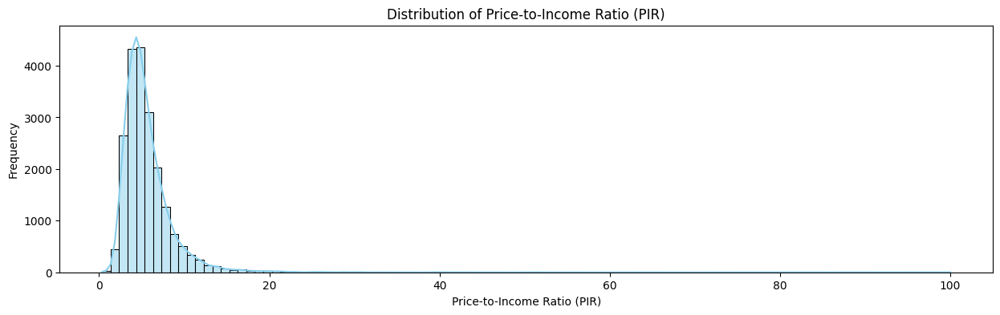

In [8]:
california_housing['PIR'] = california_housing['Median_House_Value'] / (california_housing['Median_Income'] * 10000)
plt.figure(figsize=(15, 4))
sns.histplot(california_housing['PIR'], bins=100, kde=True, color='skyblue')
plt.title('Distribution of Price-to-Income Ratio (PIR)')
plt.xlabel('Price-to-Income Ratio (PIR)')
plt.ylabel('Frequency')
plt.show()

#### Handling Right-Skewed Distributions

A right-skewed distribution has a long "tail" on the right side, indicating the presence of extreme values that are much larger than the majority of the data.

Log transformation can help balance skewed feature data, making features more normal-like.

📖 [Linear Regression Models with Logarithmic Transformations](https://kenbenoit.net/assets/courses/ME104/logmodels2.pdf)


In [9]:
# Apply log transformation to PIR and visualize it 
california_housing['Log_PIR'] = np.log1p(california_housing['PIR'])

Visualizations can help us understand the data's characteristics, such as skewness, outliers, and common patterns, providing insights into the distribution and relationships within the dataset.


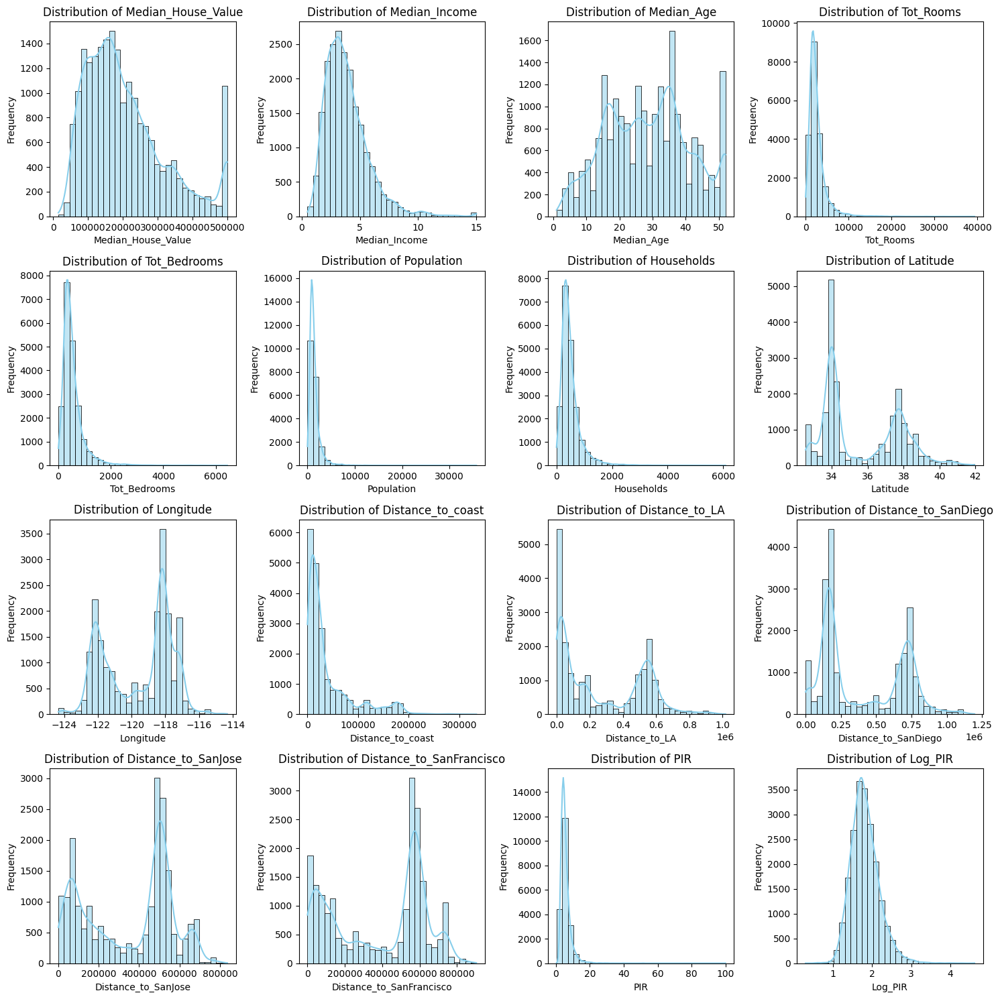

In [6]:
# Plot all feature distributions
plt.figure(figsize=(15, 15))

# Loop through each column and plot its distribution
for i, column in enumerate(california_housing.columns, 1):
    plt.subplot(4, 4, i)
    sns.histplot(california_housing[column], bins=30, kde=True, color='skyblue')
    plt.title(f'Distribution of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

💡 **Tip**: Features like Median_Income, Tot_Rooms, Households, and Distance_to_coast exhibit right-skewed distributions. However, handling these skewed features is generally unnecessary when using tree-based models(which we will use), as they are naturally robust to skewness.


### 2.3 Odd Pattern & Outliers

- Feature Median_house_value has an odd peak at its maximum value (around 500k), which could be an outlier.
- Feature Median_Age also has an odd peak at its maximum value.


In [10]:
# Identify and discard rows where Median_House_Value and Median_Age are at their maximum
median_house_value_max = california_housing['Median_House_Value'].max()
median_age_max = california_housing['Median_Age'].max()

# Filter out the outliers
california_housing = california_housing[
    (california_housing['Median_House_Value'] < median_house_value_max) &
    (california_housing['Median_Age'] < median_age_max)
]

- 🥊 **Challenge**: Plot the distributions of Median_house_value and Median_Age after removing outliers(1 point).


In [ ]:
# Plot distributions after removing outliers
# TODO


### 2.4 Correlation Matrix

This section will guide you in exploring feature relationships by calculating pairwise correlations and visualizing them using a heatmap.


Start by calculating the Pearson correlation coefficient between two features:


In [12]:
# Example: Calculate correlation between 'Median_house_value' and 'Median_Income'
correlation = california_housing['Median_House_Value'].corr(california_housing['Median_Income'])

print(f"Correlation between Median_House_Value and Median_Income: {correlation:.2f}")

Correlation between Median_House_Value and Median_Income: 0.66


The function `plot_correlation_matrix` calculates and visualizes the correlation matrix as a heatmap:


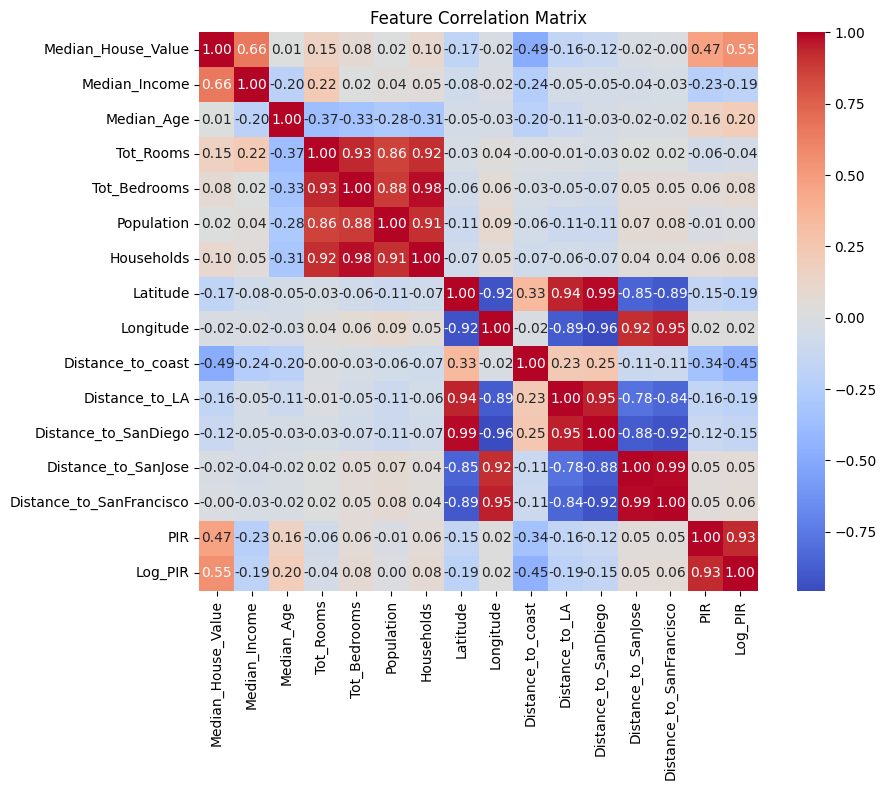

In [13]:
#Function to plot correlation of features
def plot_correlation_matrix(data, title='Correlation Matrix', figsize=(10, 8), annot=True, cmap='coolwarm'):

    # Calculate the correlation matrix
    corr_matrix = data.corr()

    # Create the heatmap
    plt.figure(figsize=figsize)
    sns.heatmap(corr_matrix, annot=annot, fmt=".2f", cmap=cmap, square=True, cbar=True)
    plt.title(title)
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()
    
#Plot the correlation matrix
plot_correlation_matrix(california_housing, title='Feature Correlation Matrix')

🔔 **Question**: What does it mean when features have a high positive or negative correlation with each other, or with the target variable?


### 2.5 Define Target Labels for Affordability

- `0`: Affordable
- `1`: Mid-range
- `2`: Expensive


In [11]:
def affordability_label(pir):
    if pir < 1.5:
        return 0  # Affordable
    elif 1.5 <= pir <= 2:
        return 1  # Mid-range
    else:
        return 2  # Expensive

california_housing.loc[:, 'Affordability'] = california_housing['Log_PIR'].apply(affordability_label)

### 2.6 Spatial Visualization

- Visualize the distribution of affordability across locations.


In [14]:
import folium
import matplotlib.cm as cm
import matplotlib.colors as colors

# Function to show affordability categories on a map
def show_affordability_on_map(data, latitude_column, longitude_column, affordability_column):
    # Use a fixed central location for the map (e.g., center of California)
    m = folium.Map(location=[37.5, -119.5], zoom_start=6)  # Approximate center of California

    # Get unique affordability categories and assign each a distinct color
    unique_affordability = data[affordability_column].unique()
    colormap = cm.get_cmap('tab10', len(unique_affordability))
    color_map = {category: colors.rgb2hex(colormap(i)[:3]) for i, category in enumerate(unique_affordability)}
    # Add points to the map
    for _, row in data.iterrows():
        folium.Circle(
            radius=400,  # Adjust radius as needed
            location=(row[latitude_column], row[longitude_column]),
            color=color_map[row[affordability_column]],
            fill_color=color_map[row[affordability_column]],
            fill=True,
            popup=f"Affordability: {row[affordability_column]}"
        ).add_to(m)
    # Add a legend for the affordability categories
    legend_html = """
    <div style="position: fixed; 
                bottom: 50px; left: 50px; width: 200px; height: auto; 
                background-color: white; border:2px solid grey; z-index:9999; font-size:14px;
                padding: 10px; line-height: 1.5;">
                <b>Affordability Levels</b><br>
                {}
    </div>
    """.format(
        "<br>".join(
            [f"<i style='background:{color_map[category]};width:12px;height:12px;display:inline-block;margin-right:5px;'></i>{category}" 
             for category in unique_affordability]
        )
    )
    m.get_root().html.add_child(folium.Element(legend_html))
    
    return m

# Visualize affordability on the map
affordability_map = show_affordability_on_map(california_housing, "Latitude", "Longitude", "Affordability")

# To display the map
affordability_map

C:\Users\86177\AppData\Local\Temp\ipykernel_26684\3931893799.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = cm.get_cmap('tab10', len(unique_affordability))


## 3. Housing Affordability Classification


In [12]:
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

### 3.1 Data preparation


In [13]:
# Define the features and target variable
features = ['Median_Age', 'Tot_Rooms', 'Tot_Bedrooms', 'Population',
            'Households', 'Latitude', 'Longitude', 'Distance_to_coast', 
            'Distance_to_LA', 'Distance_to_SanDiego', 
            'Distance_to_SanJose', 'Distance_to_SanFrancisco']  
target = 'Affordability'
X = california_housing[features]
y = california_housing[target]

In [14]:
# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

### 3.2 Decision Tree Classifier

#### References

- 📖[Scikit-Learn Documentation: Decision Tree Classifier](https://scikit-learn.org/stable/modules/tree.html#classification)

- 📖[Scikit-Learn Documentation: Metrics and Scoring](https://scikit-learn.org/stable/modules/model_evaluation.html)


In [15]:
# Decision Tree Classifier
dt_model = DecisionTreeClassifier(random_state=42)
dt_model.fit(X_train, y_train)

DecisionTreeClassifier(random_state=42)

In [16]:
# Predictions and Evaluation for Decision Tree
dt_predictions = dt_model.predict(X_test)
print("Decision Tree Classification Report:")
print(classification_report(y_test, dt_predictions))
print("Confusion Matrix:")
print(confusion_matrix(y_test, dt_predictions))
print("Accuracy:", accuracy_score(y_test, dt_predictions))

Decision Tree Classification Report:
              precision    recall  f1-score   support

           0       0.54      0.56      0.55       690
           1       0.70      0.70      0.70      2105
           2       0.57      0.56      0.57       920

    accuracy                           0.64      3715
   macro avg       0.61      0.61      0.61      3715
weighted avg       0.64      0.64      0.64      3715

Confusion Matrix:
[[ 387  275   28]
 [ 278 1472  355]
 [  47  355  518]]
Accuracy: 0.6398384925975774


In [17]:
# Cross-validation for Decision Tree
dt_cv_scores = cross_val_score(dt_model, X_train, y_train, cv=5, scoring='accuracy')
print("\nDecision Tree Cross-Validation Accuracy:", dt_cv_scores)
print("Average CV Accuracy for Decision Tree:", dt_cv_scores.mean())


Decision Tree Cross-Validation Accuracy: [0.62079408 0.63055182 0.64422753 0.62403231 0.62369573]
Average CV Accuracy for Decision Tree: 0.6286602931070332


🔔 **Question**: What is the purpose of cross-validation, and how should we interpret the results(1 point)?


🥊 **Challenge**: Make predictions and evaluate on training set and answer why it is important to assess model performance using separate training and test datasets(2 point).


### 3.3 Random Forest Classifier

#### References

- 📖[Scikit-Learn Documentation: Random Forest Classifier](https://scikit-learn.org/stable/modules/ensemble.html#forest)


In [18]:
# Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [19]:
# Predictions and Evaluation for Random Forest
rf_predictions = rf_model.predict(X_test)
print("\nRandom Forest Classification Report:")
print(classification_report(y_test, rf_predictions))
print("Confusion Matrix:")
print(confusion_matrix(y_test, rf_predictions))
print("Accuracy:", accuracy_score(y_test, rf_predictions))


Random Forest Classification Report:
              precision    recall  f1-score   support

           0       0.66      0.59      0.62       690
           1       0.73      0.82      0.77      2105
           2       0.73      0.57      0.64       920

    accuracy                           0.72      3715
   macro avg       0.71      0.66      0.68      3715
weighted avg       0.72      0.72      0.71      3715

Confusion Matrix:
[[ 407  276    7]
 [ 188 1733  184]
 [  21  379  520]]
Accuracy: 0.7160161507402423


In [20]:
cv_scores = cross_val_score(rf_model, X_train, y_train, cv=5, scoring='accuracy')
print("Cross-validation Scores:", cv_scores)
print("Mean Cross-validation Accuracy:", cv_scores.mean())

Cross-validation Scores: [0.69751009 0.7217362  0.71289128 0.71558398 0.70649613]
Mean Cross-validation Accuracy: 0.7108435377786073


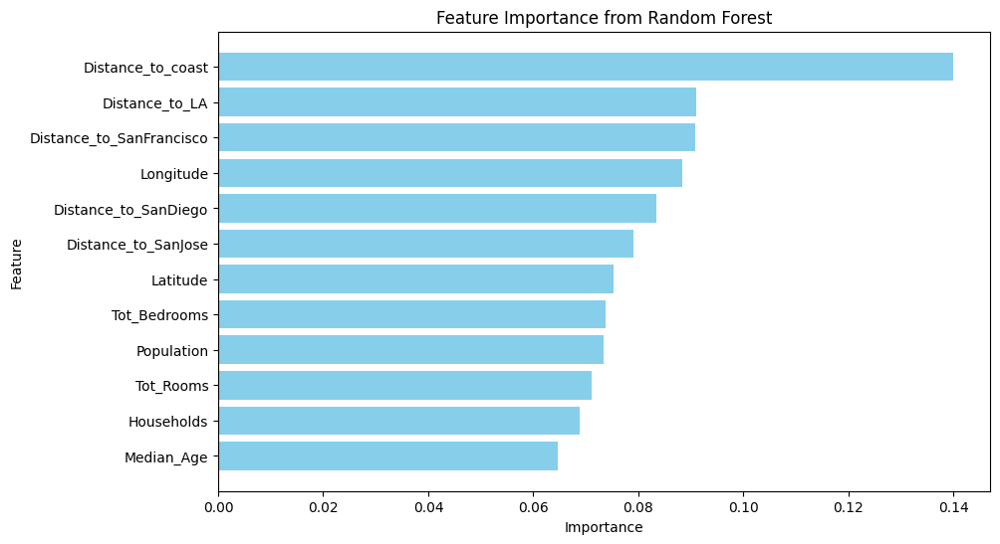

In [22]:
# Feature Importance for Random Forest
importance = rf_model.feature_importances_
feature_importance = pd.DataFrame({'Feature': features, 'Importance': importance}).sort_values(by='Importance', ascending=False)

# Plot feature importance
plt.figure(figsize=(10, 6))
plt.barh(feature_importance['Feature'], feature_importance['Importance'], color='skyblue')
plt.title('Feature Importance from Random Forest')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.gca().invert_yaxis()  # Invert the y-axis to show the most important feature at the top
plt.show()

## 4. 🔔 **Question**: What is the main reason to use a random forest versus a decision tree?

- Review the lecture materials on Decision Trees and Random Forests and answer the question(1 point).
